# deeplab-pytorch
 - mkdir checkpoint
 - download checkpoint to checkpoint folder
 - todo: 
 
# neural-style
 - sh models/download_models

In [1]:
from utils import dataset
from utils import processing

dataset.func1()
dataset.func2()
processing.func3()
processing.func4()

i am func 1
i am func 2
i am func 3
i am func 4


In [1]:
from abraham.utils import dataset
from abraham.utils import processing
from abraham.repos import repo1

dataset.func1()
dataset.func2()
processing.func3()
processing.func4()
print("===")
repo1.funcr()

i am func 1
i am func 2
i am func 3
i am func 4
===
rel import 1
i am func 1
rel import 2


th external/neural-style/neural_style.lua -proto_file external/neural-style/models/VGG_ILSVRC_19_layers_deploy.prototxt -model_file external/neural-style/models/VGG_ILSVRC_19_layers.caffemodel -backend cudnn -cudnn_autotune -content_image /tmp/tmp2xo_3an1.png -style_image /tmp/tmpty87ujvq.png -output_image /tmp/tmp8vjpsjhi.png -init random  -num_iterations 500 -image_size 1024 -content_weight 5.0000 -style_weight 100.0000 -tv_weight 0.0010 -style_scale 1.0000 -save_iter 0 -gpu 0 -multigpu_strategy 3,6,12   -lbfgs_num_correction 0


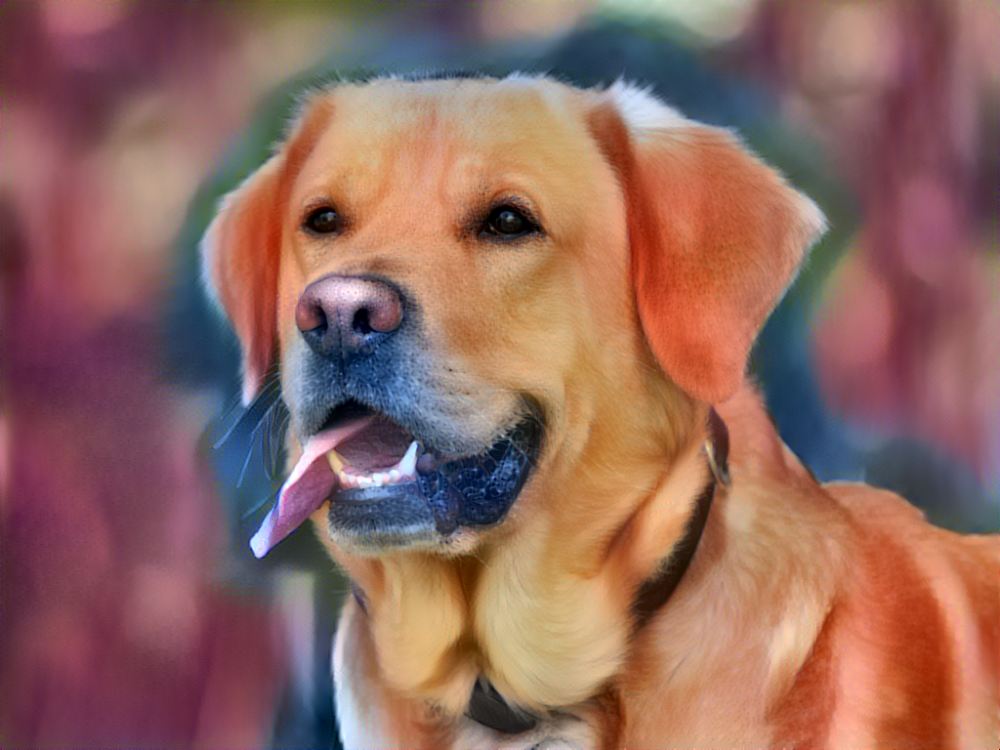

In [4]:
import abraham.setup
from abraham.utils import dataset
from abraham.utils import processing
from abraham.canvas import canvas
from abraham.external import neuralstyle


abraham.setup.set_external_repos_root("external")


data = dataset.ImageLoader()
data.load_directory('./images', 4, shuffle=True)
#data.load_movie('/Users/itpstudent/Downloads/test/ml4a-guides/assets/neural-painter-interpolation.mp4', 10, False)


save_dir = ''
f1 = '%s/train' % save_dir
f2 = '%s/test' % save_dir

img1 = data.get_image(0)
img2 = data.get_image(1)



# augment
# transform img
#data.get_next



params = {
    'content': img1['data'],
    'style': img2['data'],
    'image_size': 1024,
    'num_iterations': 500
}


img_out = neuralstyle.run(params)

processing.show_image(img_out)
    

Device: GeForce GTX 1080 Ti


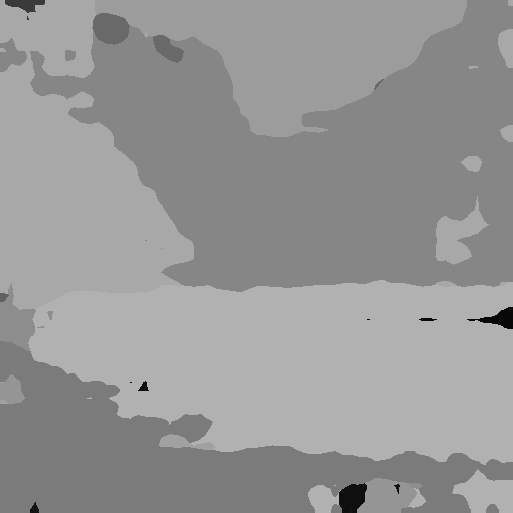

In [2]:
import abraham.setup
from abraham.utils import processing, dataset
from abraham.external import deeplabpytorch

abraham.setup.set_external_repos_root("external")


data = dataset.ImageLoader()
data.load_directory('./images', 4, shuffle=True)
img1 = data.get_image(0)

deeplabpytorch.setup(deeplabpytorch.Config.cocostuff164k)
labelmap = deeplabpytorch.run(img1['data'])
labelmap_img = deeplabpytorch.labelmap_as_image(labelmap)

processing.show_image(labelmap_img)

In [1]:
import numpy as np
import abraham.setup
from abraham.utils import processing, dataset
from abraham.external import spade

abraham.setup.set_external_repos_root("external")


data = dataset.ImageLoader()
data.load_directory('./images', 4, shuffle=True)
img1 = data.get_image(0)

spade.setup('landscape_44k')
out = spade.run(np.array(img1['data'])[:,:,0])
processing.show_image(out)


set neural-style to external/neural-style
set deeplab-pytorch to external/deeplab-pytorch
set spade to external/SPADE
Network [SPADEGenerator] was created. Total number of parameters: 97.4 million. To see the architecture, do print(network).


RuntimeError: cuDNN error: CUDNN_STATUS_NOT_INITIALIZED

set neural-style to external/neural-style
set deeplab-pytorch to external/deeplab-pytorch
set spade to external/SPADE
Network [SPADEGenerator] was created. Total number of parameters: 97.4 million. To see the architecture, do print(network).


/home/bzion/art/abraham/external/deeplabpytorch.py:47: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  CONFIG = Dict(yaml.load(open(config_path, 'rb')))


Device: GeForce GTX 1080 Ti


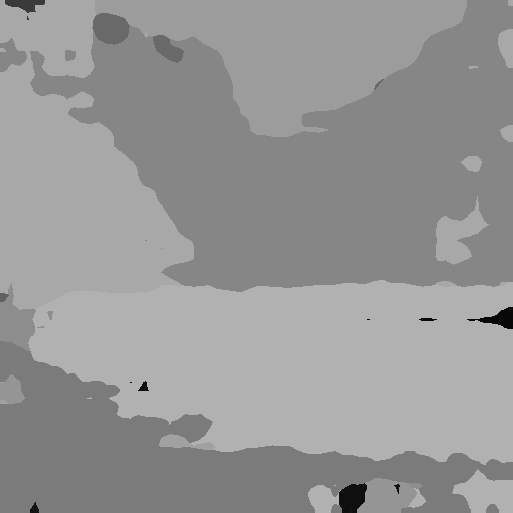

/home/bzion/.local/share/virtualenvs/art-QFGnCPiF/lib/python3.5/site-packages/torch/nn/functional.py:1374: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


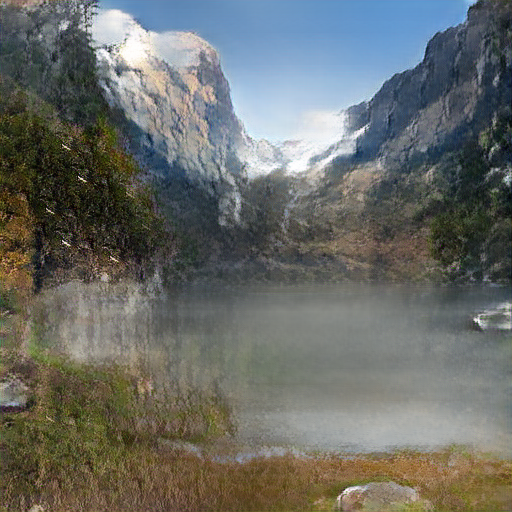

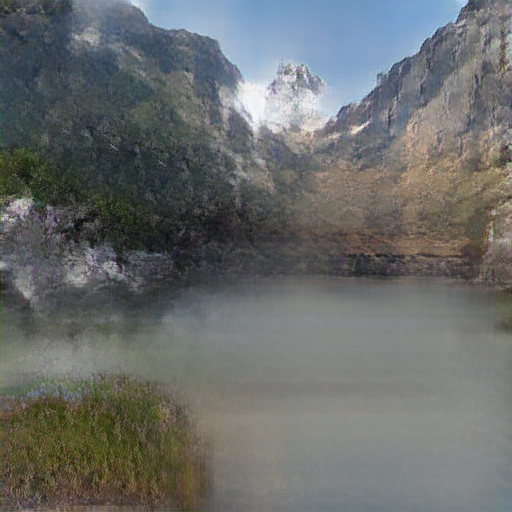

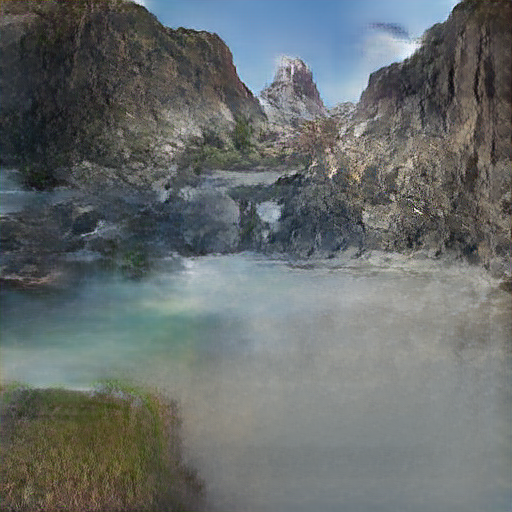

In [1]:
import numpy as np
import abraham.setup
from abraham.utils import processing, dataset
from abraham.external import deeplabpytorch, spade

abraham.setup.set_external_repos_root("external")


spade.setup('landscape_44k')
deeplabpytorch.setup(deeplabpytorch.Config.cocostuff164k)


data = dataset.ImageLoader()
#data.load_directory('./images', 4, shuffle=True)
#img1 = data.get_image(0)
img1 = data.load_image('./images/mountains.jpg')


labelmap = deeplabpytorch.run(img1['data'])
labelmap_img = deeplabpytorch.labelmap_as_image(labelmap)

processing.show_image(labelmap_img)

out2 = spade.run(labelmap_img)
processing.show_image(out2)


for i in range(2):
    labelmap = deeplabpytorch.run(out2)
    labelmap_img = deeplabpytorch.labelmap_as_image(labelmap)
    out2 = spade.run(labelmap_img)
    processing.show_image(out2)



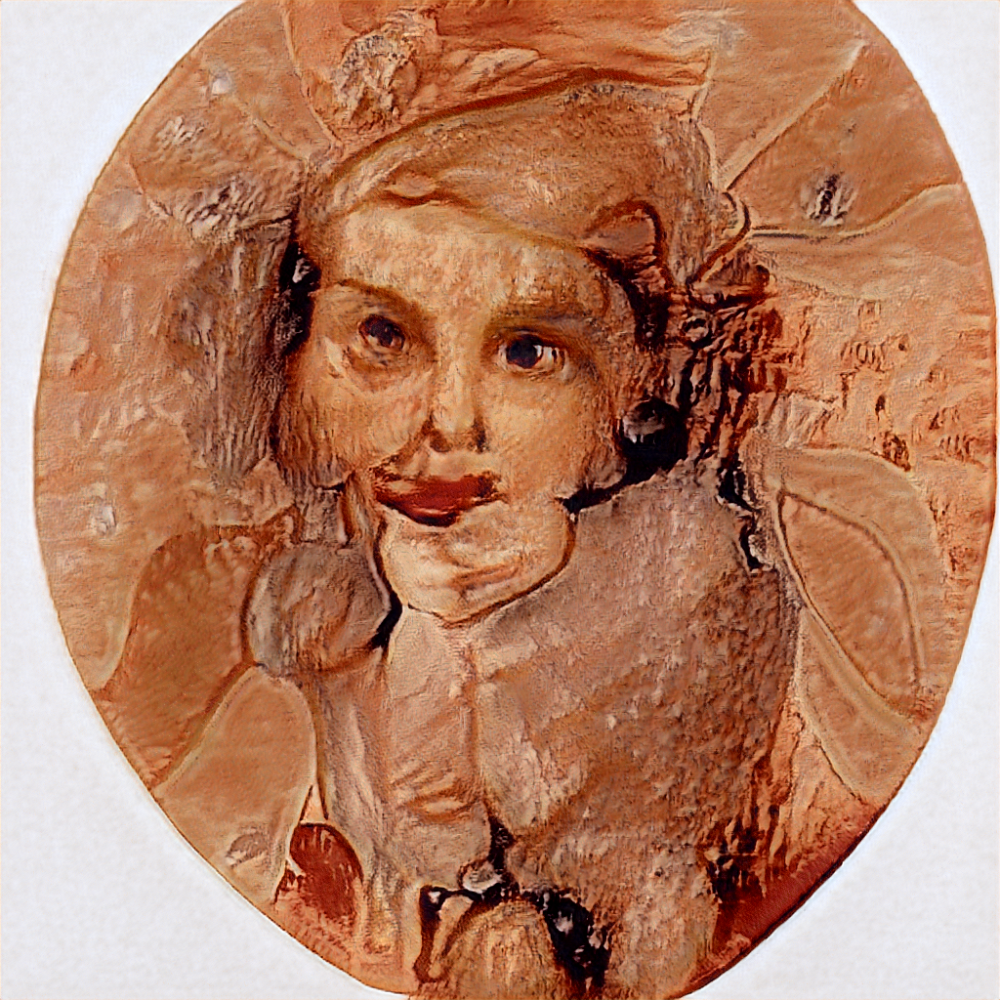

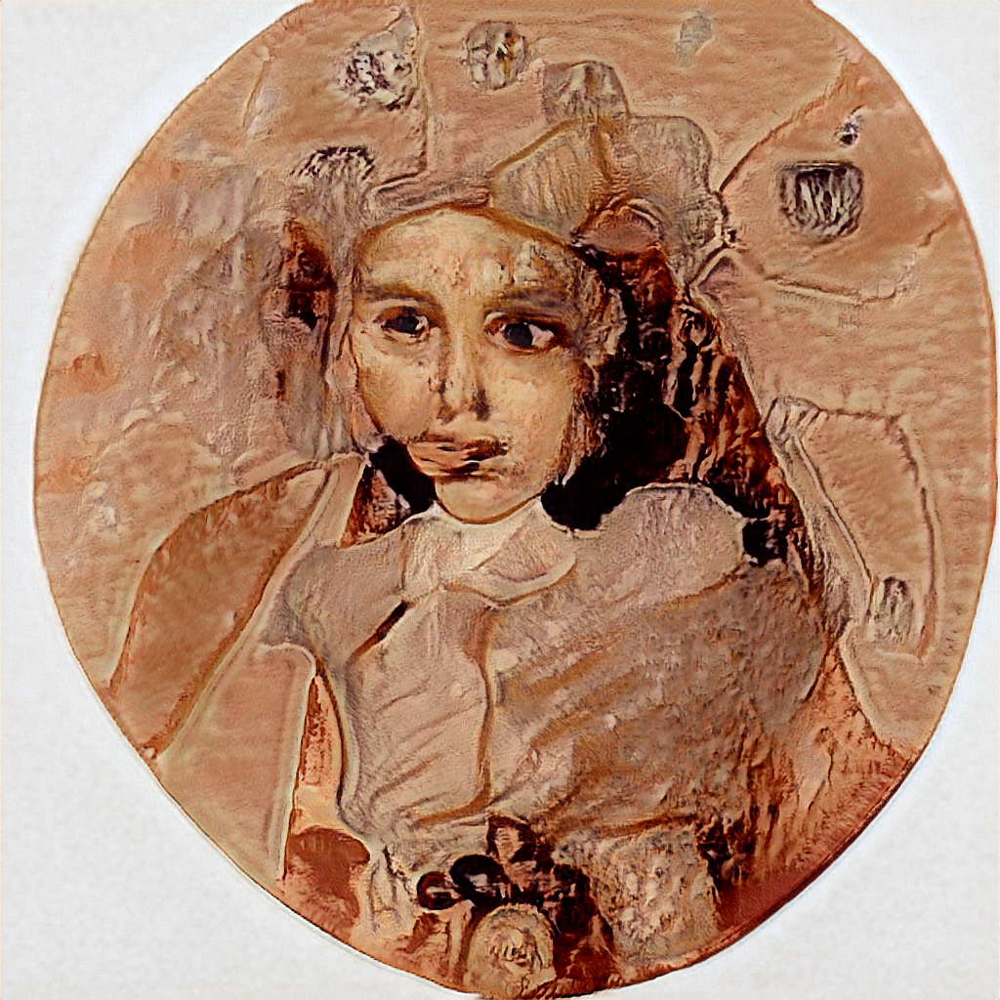

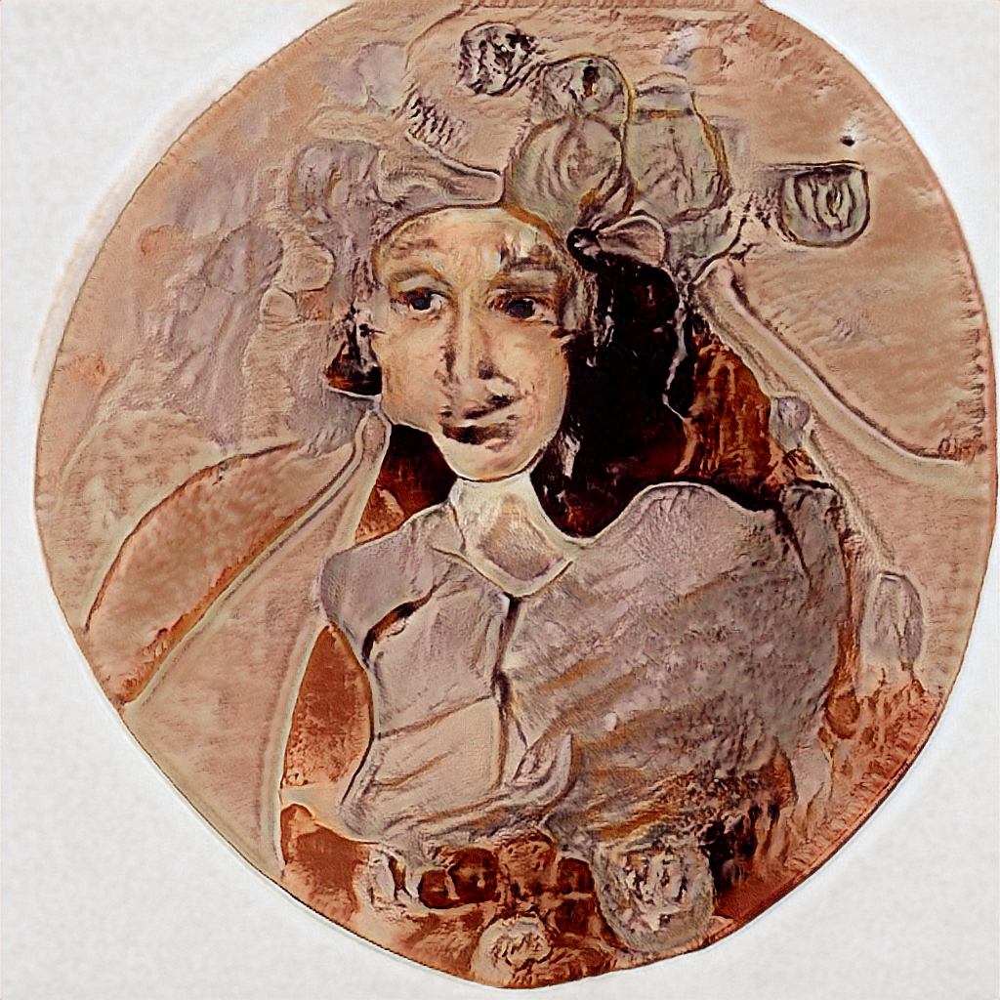

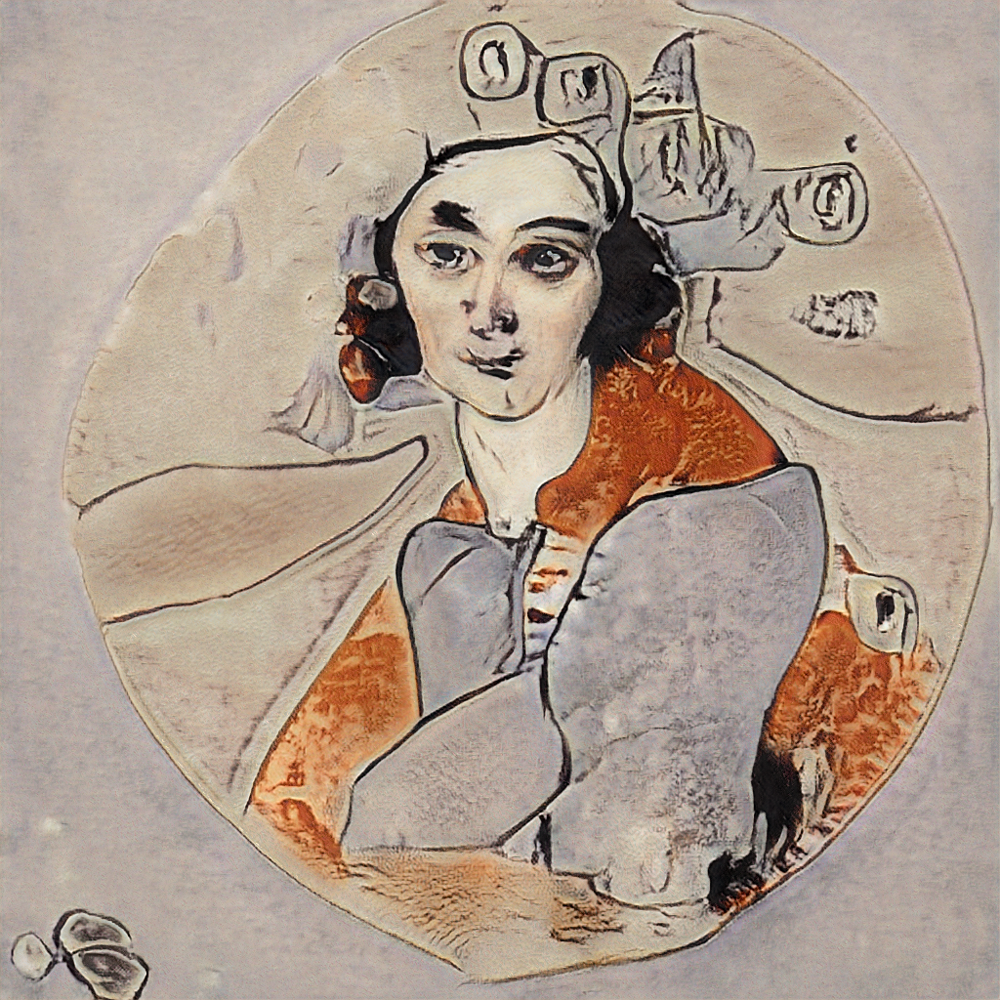

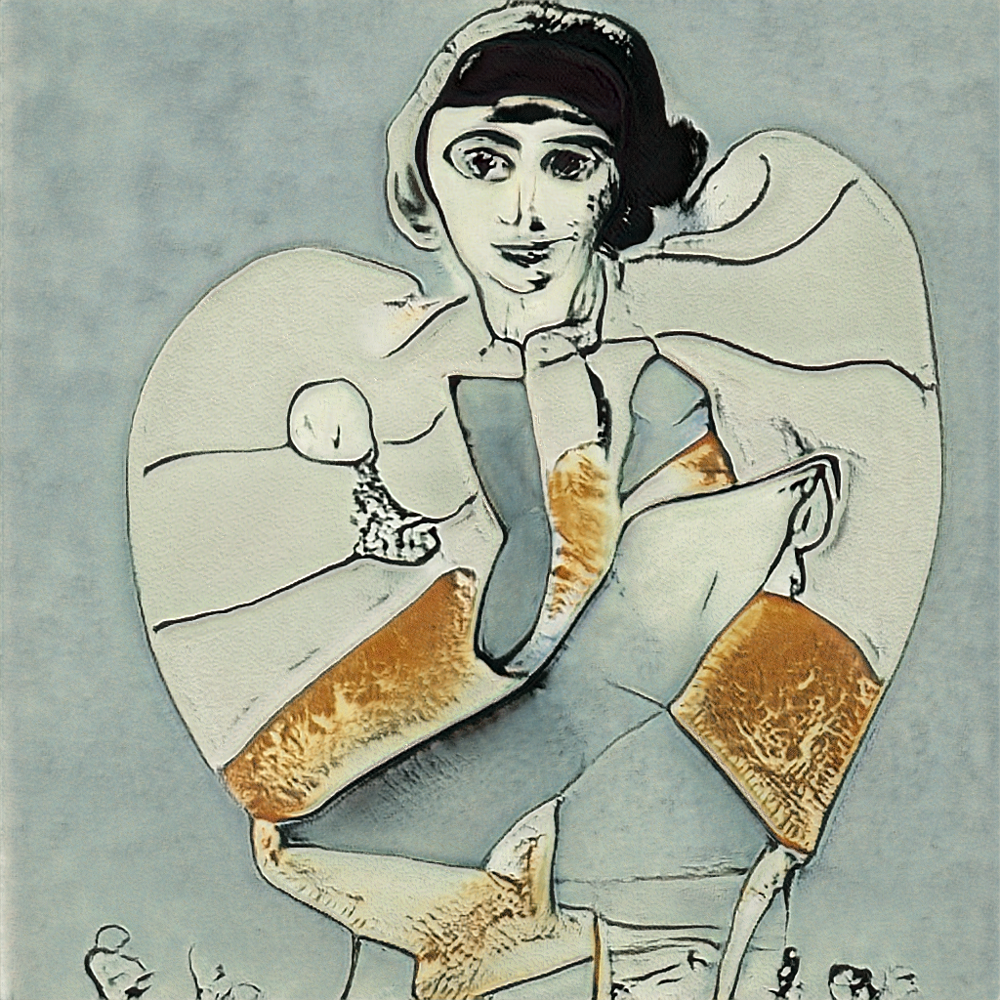

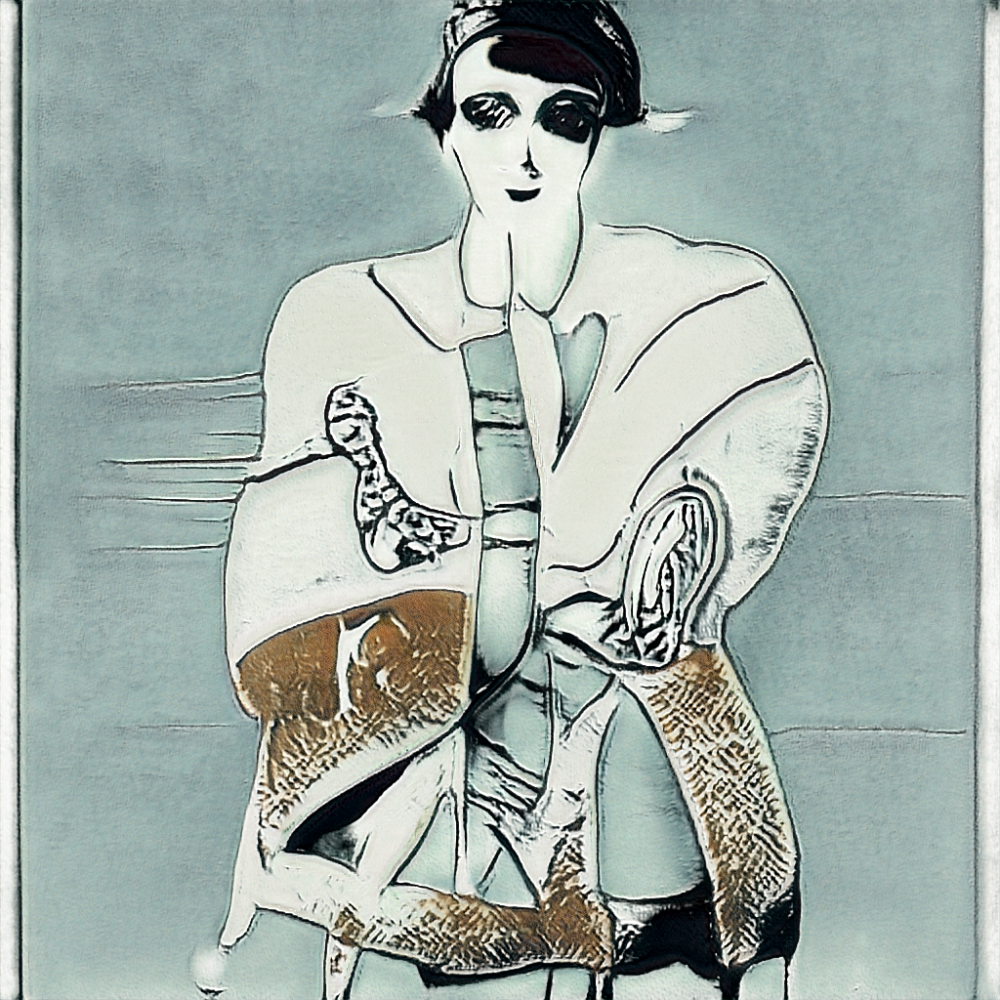

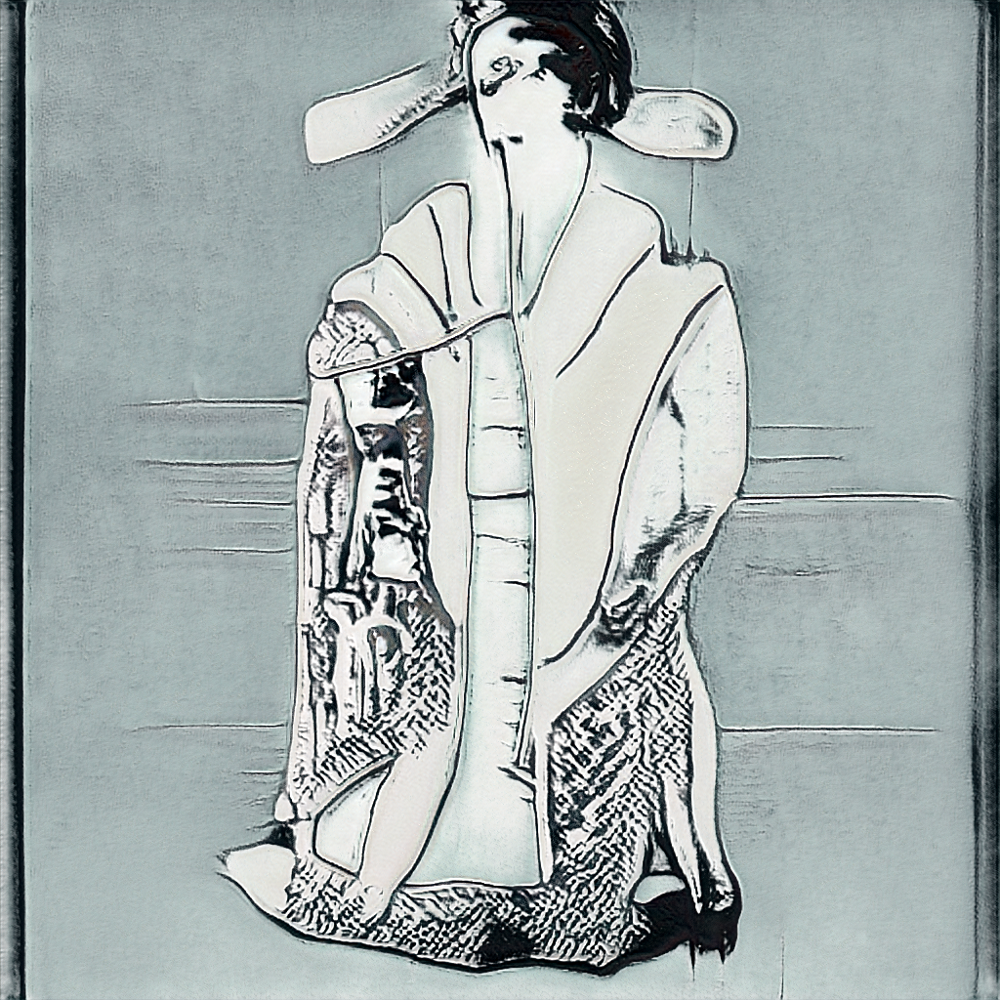

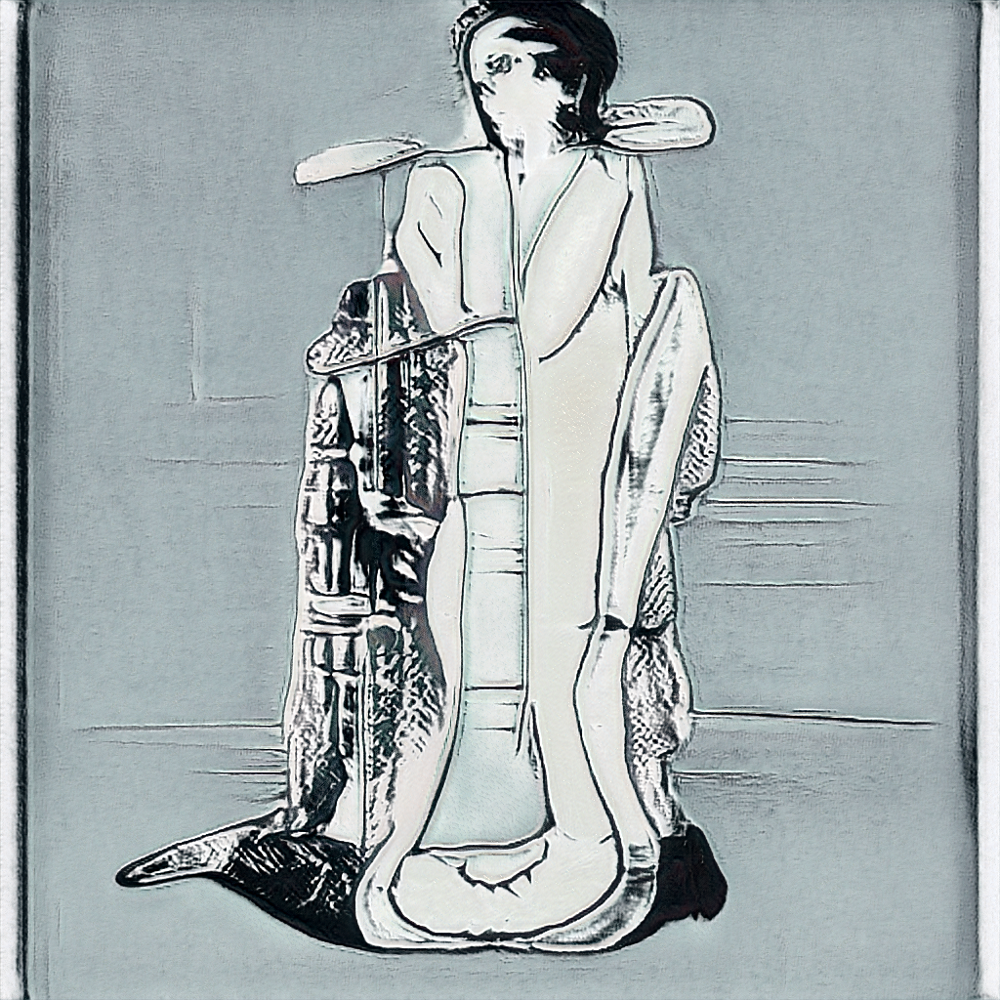

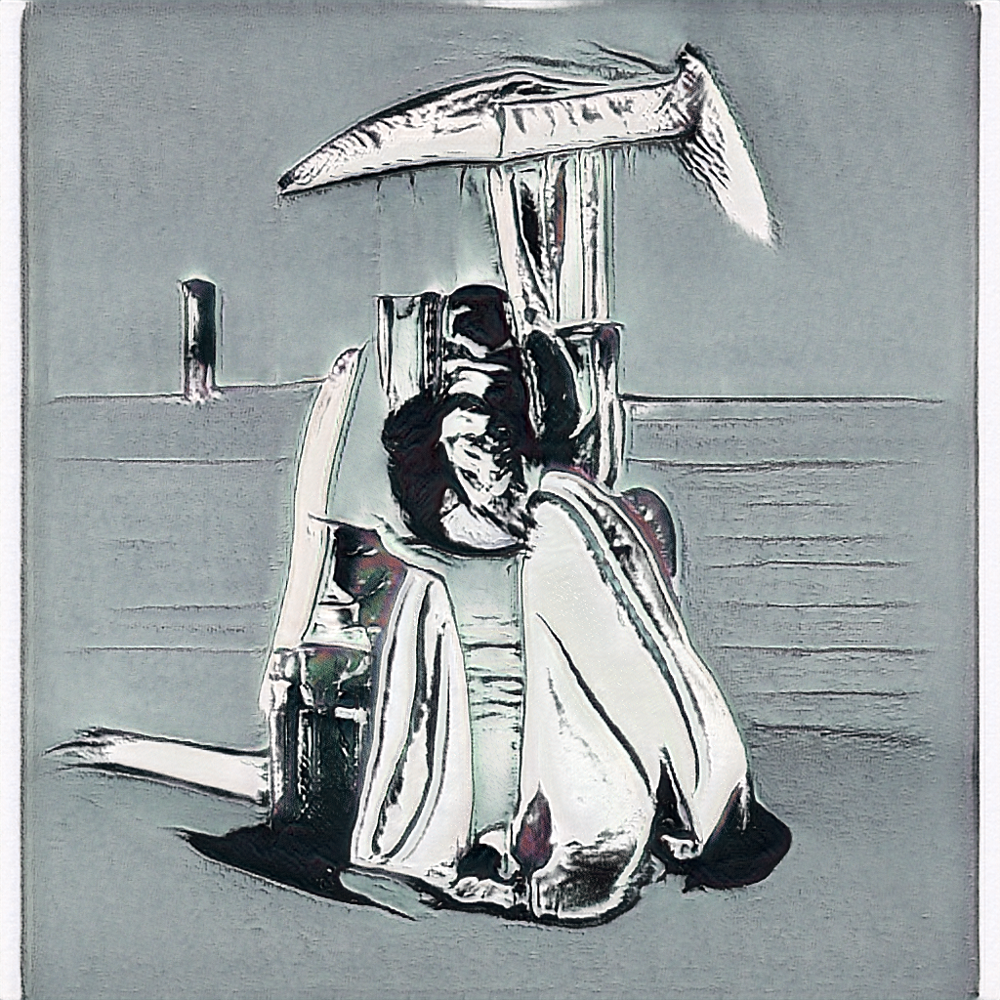

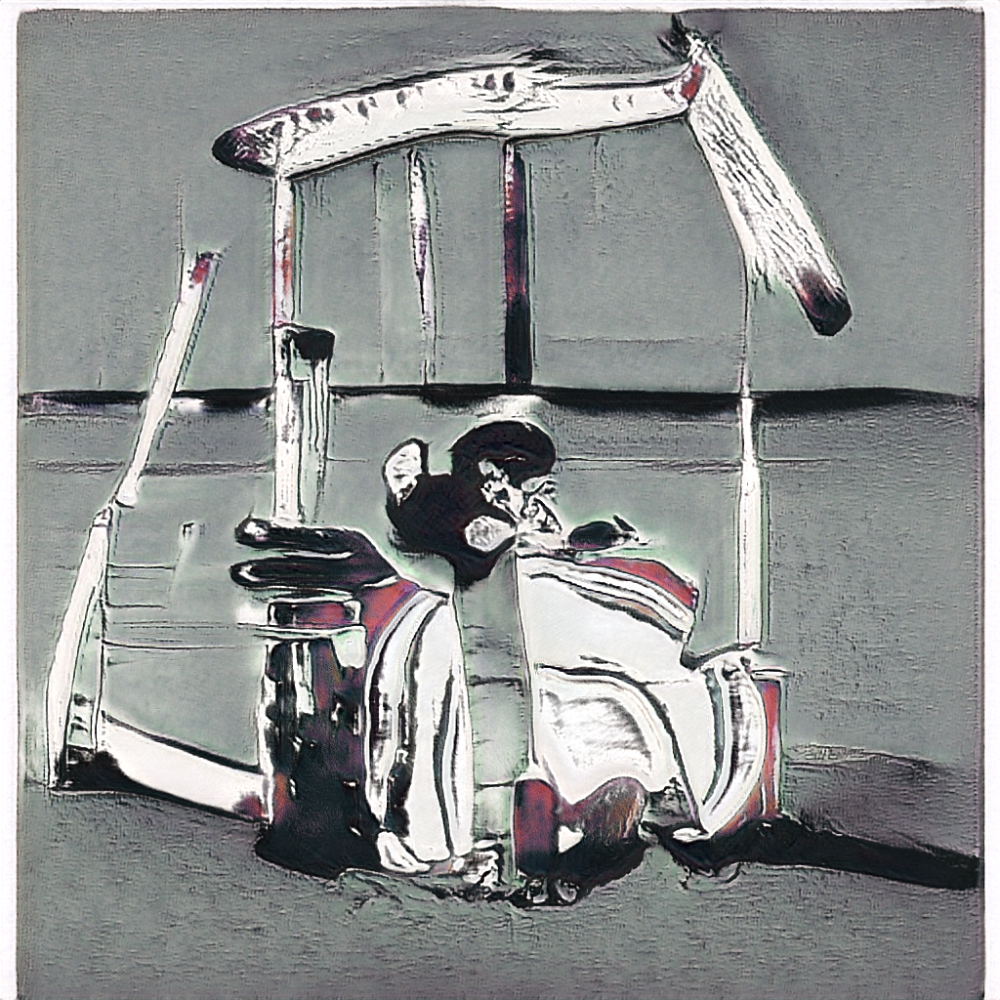

In [3]:
import numpy as np
import abraham.setup
from abraham.utils import processing
from abraham.external import stylegan

abraham.setup.set_external_repos_root("external")


#stylegan.setup('network-final-wikiarts.pkl')

z1 = np.random.RandomState(600).randn(1, 512)
z2 = np.random.RandomState(88).randn(1, 512)
#output = stylegan.run(z, truncation=1.0)
#processing.show_image(output)

for i in range(10):
    t = float(i)/9.0
    z0 = (1.0-t) * z1 + t * z2
    output = stylegan.run(z0, truncation=1.0)
    processing.show_image(output)
    



'1.14.0'